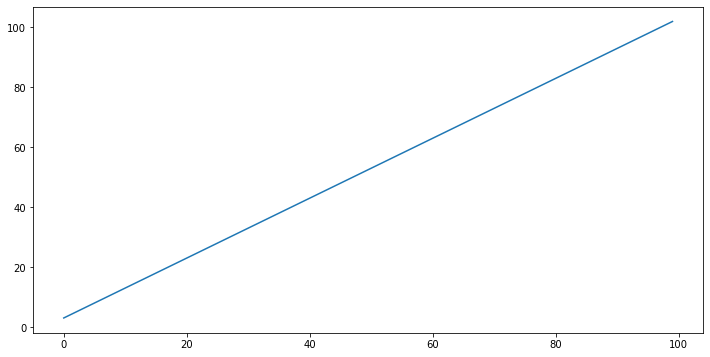

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

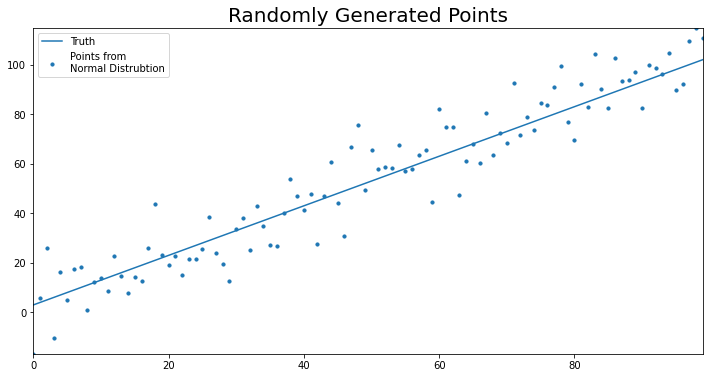

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

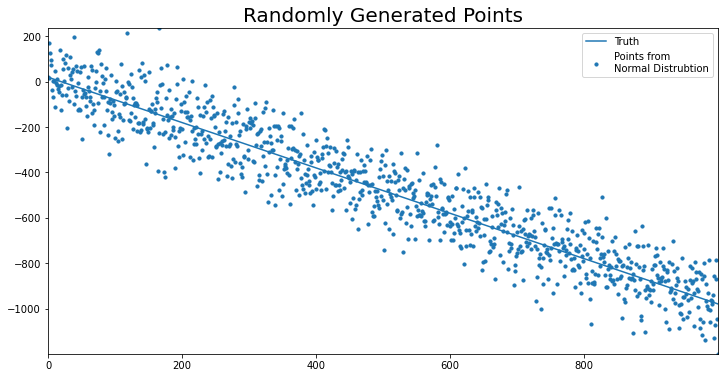

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

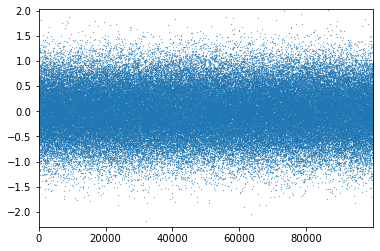

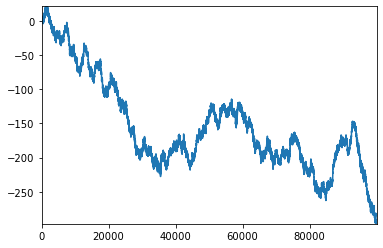

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 1000
for i in range(num_sims):
    monte_carlo_sim_dict[i] = {}
    for period in range(periods):
        # create variable that references simulation i 
        # in the dictionary
        curr_sim = monte_carlo_sim_dict[i]
        if period == 0:
            curr_sim[period] = random.normalvariate(mean, sigma)
        else:
            curr_sim[period] = curr_sim[period - 1] + random.normalvariate(mean, sigma)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.212439,-0.343677,-0.614241,0.019129,0.222776,1.481886,-0.083682,0.735045,-1.281981,0.575391,...,1.335362,-1.463251,-0.269041,-1.416597,-0.159520,0.286319,-1.020014,-1.497081,-2.171526,0.475456
1,1.873435,1.590302,-0.678494,-0.591582,0.938906,1.482139,-1.152714,0.981013,-2.084579,-0.886261,...,0.984161,-1.669729,-0.412745,-0.736103,-0.984312,0.322712,0.079966,-1.795319,-1.317185,0.510118
2,1.251516,2.567658,-1.130092,-1.203372,0.697259,2.694936,-0.542868,-0.802824,-2.113641,-0.648301,...,1.233365,-1.650174,-1.515009,-3.126784,0.765068,0.943327,1.066951,-0.203284,0.644644,-1.135175
3,0.913132,3.500655,-1.137729,-1.243457,0.256184,3.142278,-0.286284,-0.213899,-2.322119,-1.101176,...,2.566706,0.430543,-0.913803,-2.846331,0.213333,1.579362,2.962800,-1.160493,0.195627,-1.403121
4,0.730026,1.422068,-1.007089,-2.138205,-0.881076,3.565725,0.326952,0.262492,-3.491807,-1.008068,...,3.503767,1.588262,-0.699949,-1.079588,0.486980,1.520053,1.861977,-1.929449,-0.992492,-2.332007
5,0.804119,0.419925,-2.056717,-0.874147,-2.229864,4.650222,-0.259354,-0.729270,-4.873462,-0.000651,...,4.193207,2.681346,-1.264380,-1.329976,-0.520307,1.311945,0.800174,-0.271033,-0.541648,-1.924613
6,1.295701,0.744500,-0.668224,0.831703,-1.771050,5.228458,1.504434,0.251194,-4.654623,0.136024,...,5.065273,2.097813,-1.542014,-3.108053,-1.085813,2.461548,-0.307361,-0.668646,0.766435,-0.794827
7,4.433664,2.598683,0.249903,0.584467,-2.600255,3.233891,1.138201,-0.055896,-4.330859,0.145140,...,5.463202,2.198990,-2.304645,-1.625374,-0.607105,3.484154,0.465421,-1.117673,1.403239,-1.285092
8,4.697947,2.855748,-0.257636,1.991862,-2.373608,2.872468,2.549562,-1.656933,-4.576601,0.023183,...,5.943499,1.038272,-2.220150,-1.715916,0.144207,1.007457,1.817563,-1.192189,1.246325,-0.946370
9,5.613535,3.782426,-2.448959,2.376188,-1.678882,3.276152,2.576146,-0.566882,-3.735499,-0.990618,...,6.894328,2.340892,-2.096374,-2.464700,-0.244704,-0.198048,1.910598,0.279157,0.914334,-0.495807


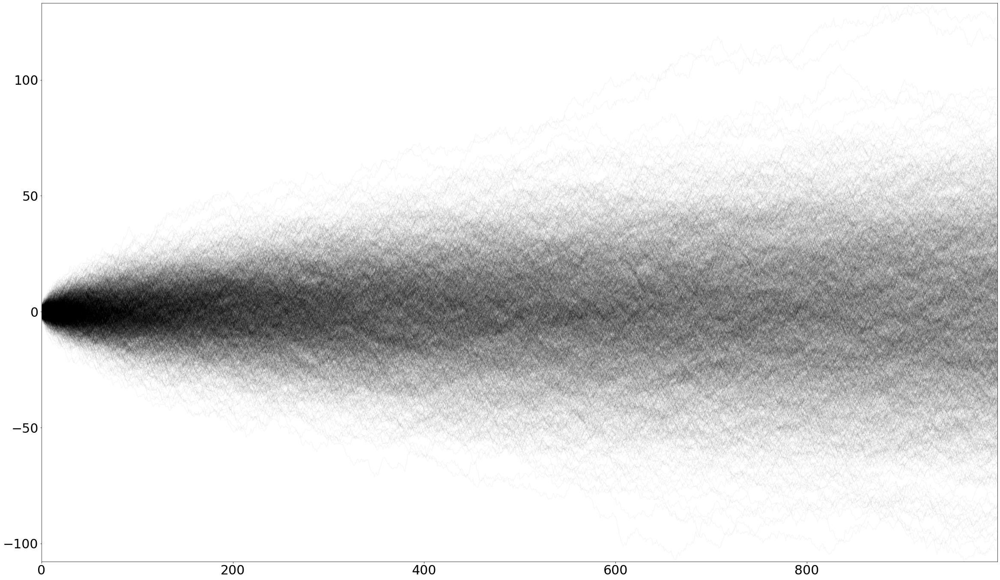

In [6]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, ax = ax)

plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  import sys


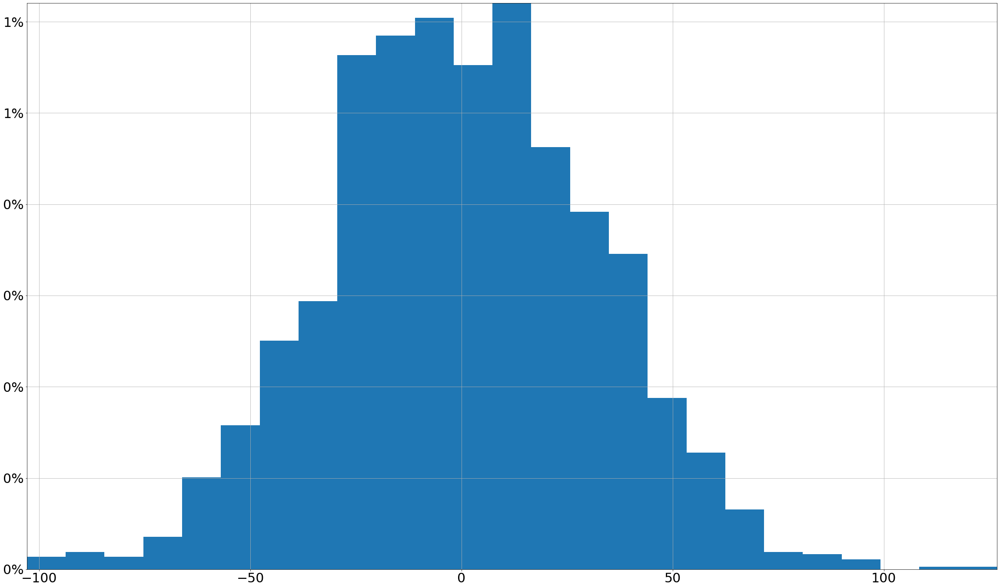

In [7]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [8]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 1000
for i in range(num_sims):
    monte_carlo_sim_dict[i] = {}
    for period in range(periods):
        # create variable that references simulation i 
        # in the dictionary
        curr_sim = monte_carlo_sim_dict[i]
        if period == 0:
            curr_sim[period] = random.normalvariate(mean, sigma)
        else:
            curr_sim[period] = curr_sim[period - 1] + random.normalvariate(mean, sigma)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.312052,0.294074,-0.259311,-0.324232,0.346129,-0.520262,-0.390448,0.361509,0.503003,0.014353,...,0.483665,-0.604880,-0.007025,0.456844,-0.300460,-0.529159,-0.159983,1.044231,-0.757419,0.652573
1,0.519321,-0.136294,-1.084595,-0.289434,0.485107,-0.461952,-0.850408,0.560954,-0.538592,0.137783,...,0.688687,-0.430642,0.384332,0.556870,-0.697579,-0.792215,0.323245,1.290786,-0.478725,1.006718
2,1.821377,-0.197572,-1.808397,-0.048725,0.163333,-0.068368,-1.297123,1.097026,0.116014,1.233103,...,0.949354,-1.524800,0.713251,-0.068705,-0.673276,-1.545493,-0.869020,1.208298,-0.195788,1.045729
3,2.546630,-0.346094,-1.992616,1.033908,0.878093,0.140647,-0.665923,0.531712,-0.229029,0.813155,...,0.706443,-2.360357,0.842972,0.086381,-0.719333,-1.415979,-0.294179,1.802373,-0.226355,1.266494
4,2.008365,-0.497326,-1.538105,1.713372,0.403041,1.248426,-0.241550,0.273027,-0.348251,1.172998,...,0.080687,-3.044278,0.375175,0.744721,-1.414760,-1.583788,0.186663,1.664789,-0.289431,0.900914
5,1.746632,-1.051218,-2.282810,1.397165,0.512860,0.704176,-0.550417,0.142085,0.779172,1.913789,...,0.236508,-2.876927,0.414105,1.106173,-1.556508,-1.104877,-0.433924,1.818338,-0.421758,1.770110
6,1.627917,-0.497645,-1.829095,1.552655,0.995430,0.390818,-0.196028,-0.062707,1.003939,1.096093,...,0.975594,-2.407144,0.622184,1.268643,-1.092559,-0.599898,-0.119993,1.509892,0.536699,1.547756
7,1.607309,-0.716039,-1.815850,2.009075,0.064248,0.927086,0.170658,-0.586569,0.737531,1.425969,...,1.851303,-2.586727,0.965983,1.020313,-1.180761,-1.035725,0.235177,1.526412,0.651613,1.857509
8,2.163929,-0.862833,-2.317944,2.197867,-0.309989,0.586627,-0.480548,-0.648229,0.401694,1.721883,...,1.998511,-3.397365,1.856430,1.671244,-1.507663,-1.749024,-0.109007,2.140232,1.481520,1.449602
9,2.160032,-0.802709,-2.725059,1.560846,-0.337378,-0.198279,-0.405987,-0.333657,-0.514492,1.605896,...,1.356916,-4.076558,1.617037,1.995910,-0.210867,-1.323559,0.041687,1.537685,1.688511,1.361119


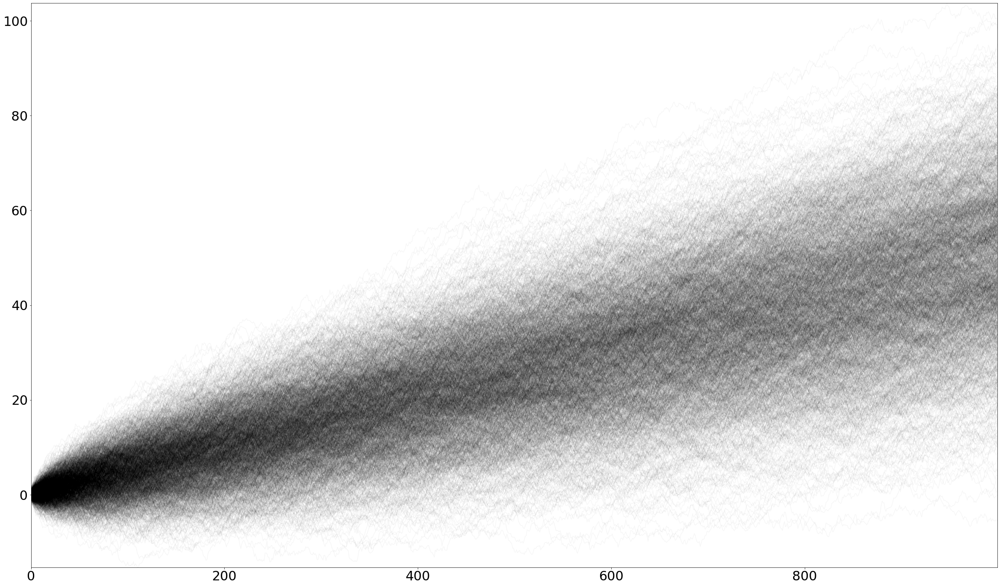

In [9]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, ax = ax)

plt.show()

### Calculating Expected Value

In [10]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0       0.056819
1       0.120117
2       0.151148
3       0.199485
4       0.244722
5       0.310753
6       0.348593
7       0.389854
8       0.453658
9       0.503591
10      0.555122
11      0.607232
12      0.656857
13      0.706144
14      0.763353
15      0.829565
16      0.886102
17      0.939000
18      0.980879
19      1.029364
20      1.087430
21      1.128293
22      1.178775
23      1.214393
24      1.282254
25      1.330182
26      1.373082
27      1.426921
28      1.467511
29      1.517374
         ...    
970    48.311665
971    48.370344
972    48.427613
973    48.489739
974    48.536814
975    48.576480
976    48.631215
977    48.669214
978    48.699716
979    48.758289
980    48.819067
981    48.881543
982    48.935343
983    48.963252
984    49.008997
985    49.067535
986    49.108249
987    49.162891
988    49.206103
989    49.274858
990    49.313674
991    49.367871
992    49.404905
993    49.441899
994    49.496940
995    49.534950
996    49.591089
997    49.6562

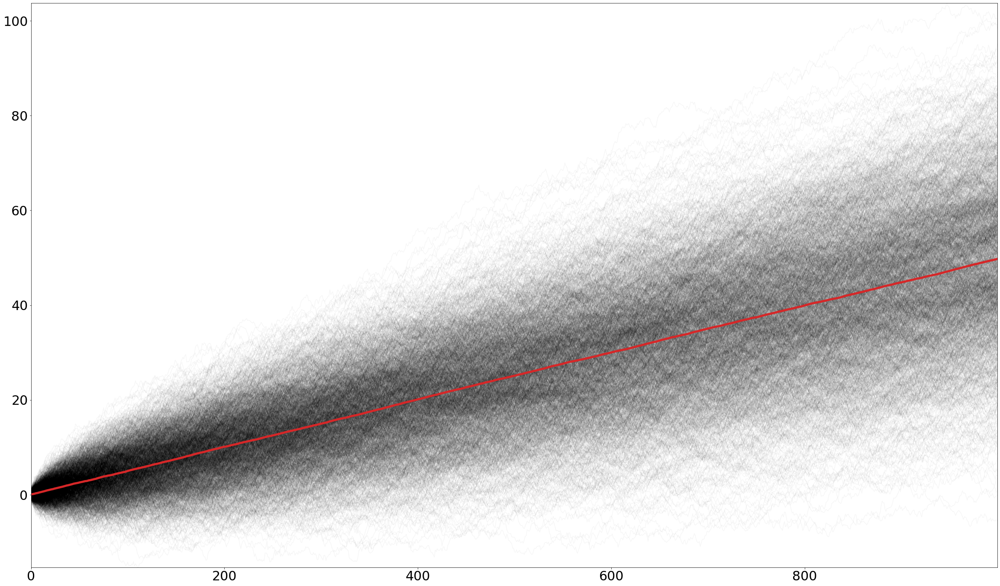

In [11]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, ax = ax)
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", linewidth = 5, ax = ax)
plt.show()

### Simulating Changes in Portfolio Values

In [12]:
import pandas_datareader.data as web
import datetime

# date is format (yyyy, mm, dd)
start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = ["MSFT", "AAPL", "IBM", "GOOG"]
for name in stocks:
    # web.DataReader(stockname, source, start_date, end_date)
    data_dict[name] = web.DataReader(name, "yahoo", start, end)
    
    
# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

In [13]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072812,-0.004366,0.028109
2005-01-10,0.004874,-0.004188,-0.001044,0.006242
2005-01-11,-0.002612,-0.063805,-0.007107,-0.007792
2005-01-12,0.001871,0.013941,0.002211,0.009507
2005-01-13,-0.019044,0.066300,-0.007982,-0.000256


<AxesSubplot:xlabel='Date'>

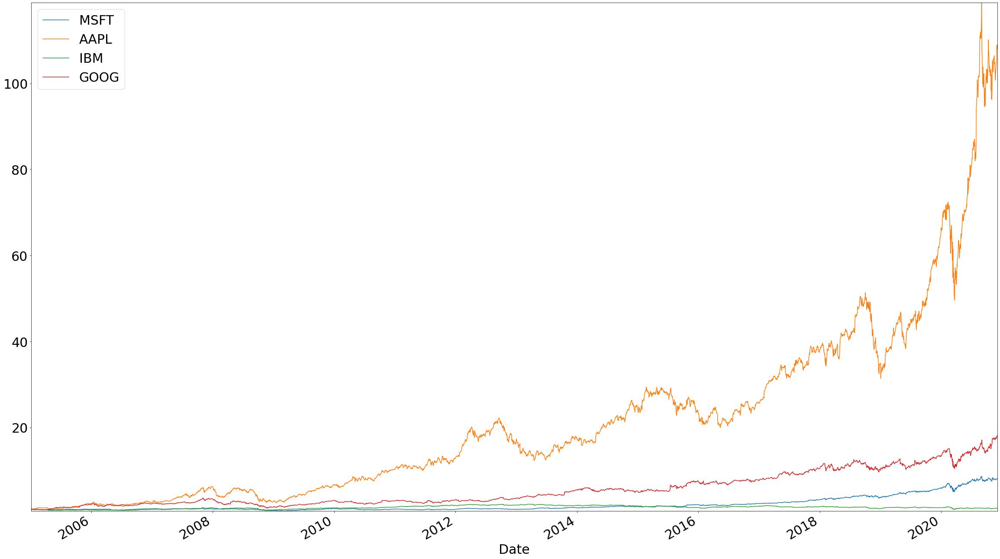

In [14]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace = True)
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax=ax)


### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [15]:
mean_var_df = pd.DataFrame({"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (1 / close_data_normalized["MSFT"].count()) - 1,
                            "sigma":close_data_pct_change.std()})

mean_var_df

,mean,sigma
MSFT,0.000520,0.017290
AAPL,0.001168,0.021044
IBM,0.000060,0.014575
GOOG,0.000722,0.018827


In [16]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock] 
    for i in range(num_sims):
        monte_carlo_sim_dict[stock][i] = {}
        curr_sim = monte_carlo_sim_dict[stock][i]

        for date in dates:
            # create variable that references simulation i 
            # in the dictionary
            curr_sim[date] = random.normalvariate(mean, sigma)
            
    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dict

{'MSFT':                  0          1          2         3         4         5    \
 2005-01-03  1.040039   1.020905   0.980442  1.009904  1.005038  0.975625   
 2005-01-04  1.051415   1.009813   0.974585  0.992439  1.020941  0.971253   
 2005-01-05  1.030127   0.991824   0.986611  1.003641  1.033545  0.980341   
 2005-01-06  1.012260   0.973637   0.992792  1.002767  1.036953  0.936887   
 2005-01-07  1.026258   0.975195   0.988547  0.993842  1.061895  0.943605   
 2005-01-10  1.034227   0.963837   1.017217  0.990299  1.079106  0.961469   
 2005-01-11  1.016307   0.942585   1.021794  1.000281  1.074851  0.983554   
 2005-01-12  1.019796   0.943209   1.058689  1.023506  1.089163  1.017594   
 2005-01-13  1.035905   0.928672   1.072898  1.019203  1.110691  1.000685   
 2005-01-14  1.032391   0.913107   1.066107  1.024352  1.136893  1.007804   
 2005-01-18  1.015811   0.906343   1.067757  1.032079  1.119544  1.003437   
 2005-01-19  1.018639   0.943647   1.110663  1.034777  1.106978  1.0

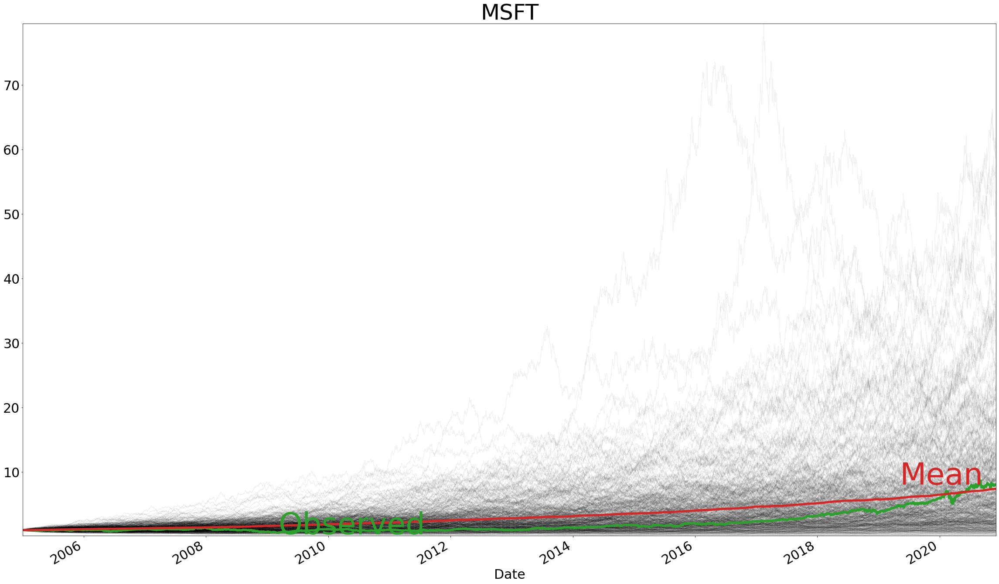

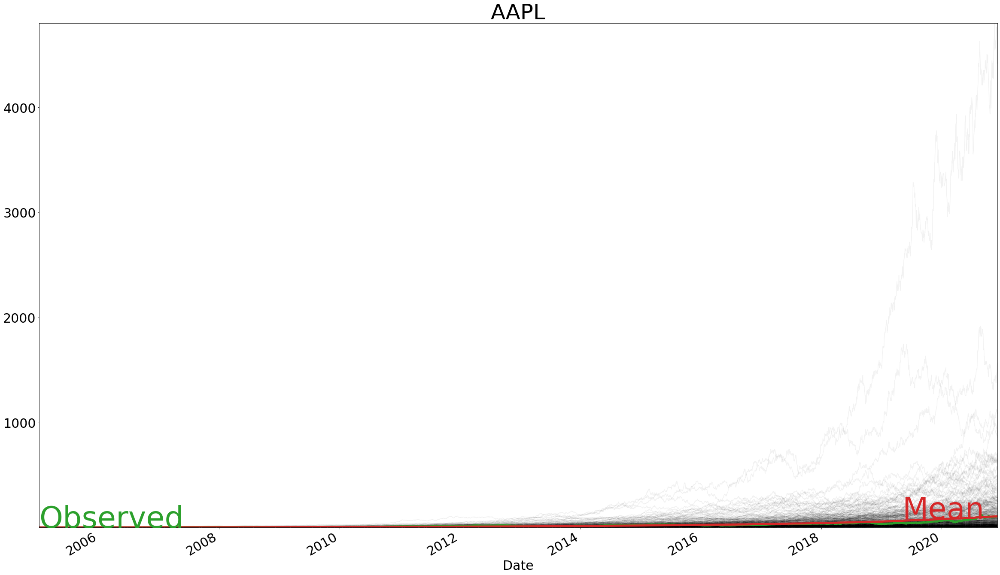

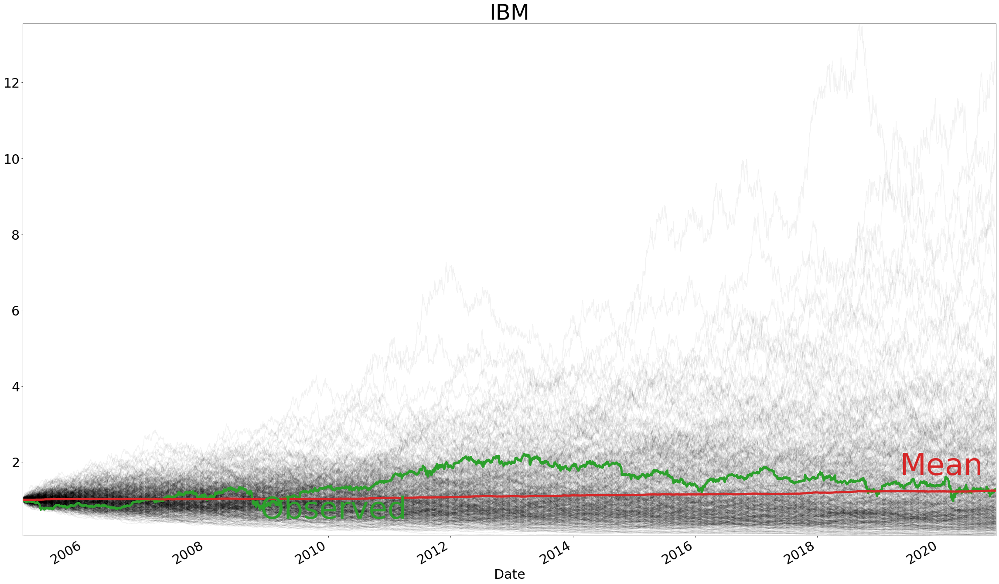

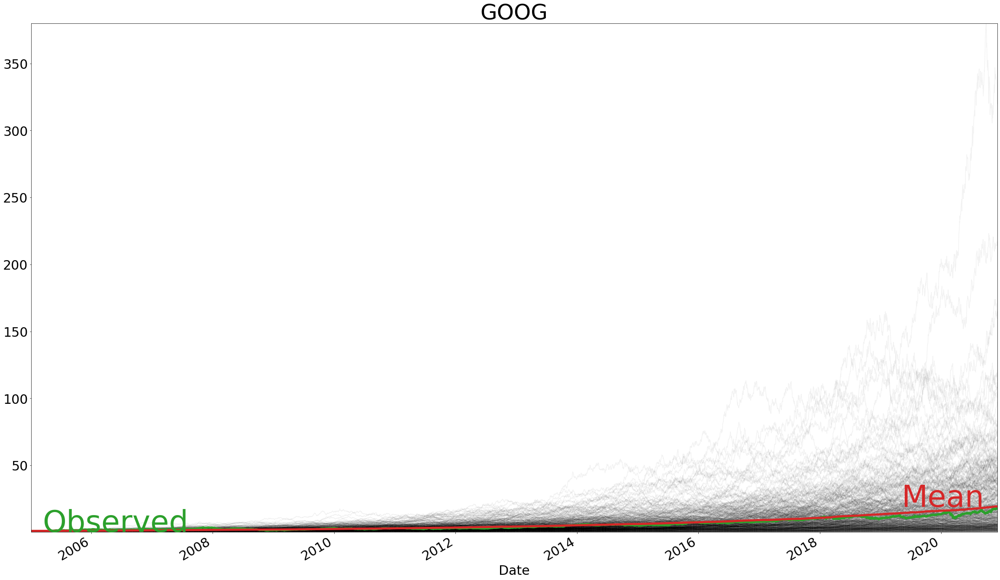

In [17]:
for stock in stocks:
    monte_carlo_sim_dict[stock]["mean"] = monte_carlo_sim_dict[stock].mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    monte_carlo_sim_dict[stock].drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = .1, 
                                color ="k", alpha = .05, ax = ax)
    close_data_normalized[stock].plot.line(legend = False, color ="C2", linewidth = 5, ax = ax, label = "Observed")
    monte_carlo_sim_dict[stock]["mean"].plot.line(legend = False, color ="C3", linewidth = 5, ax = ax)
    
    # find lowest
    obs_text_x = close_data_normalized[close_data_normalized[stock] == close_data_normalized[stock].min()].index
    plt.text(obs_text_x, close_data_normalized[stock].loc[obs_text_x] * .7 , 
         "Observed", fontsize = 70, color = "C2")
    plt.text(dates[-400], monte_carlo_sim_dict[stock]["mean"].iloc[-400] * 1.35 , 
         "Mean", fontsize = 70, color = "C3")
    
    plt.title(stock, fontsize = 50)
    plt.show()
    plt.close()

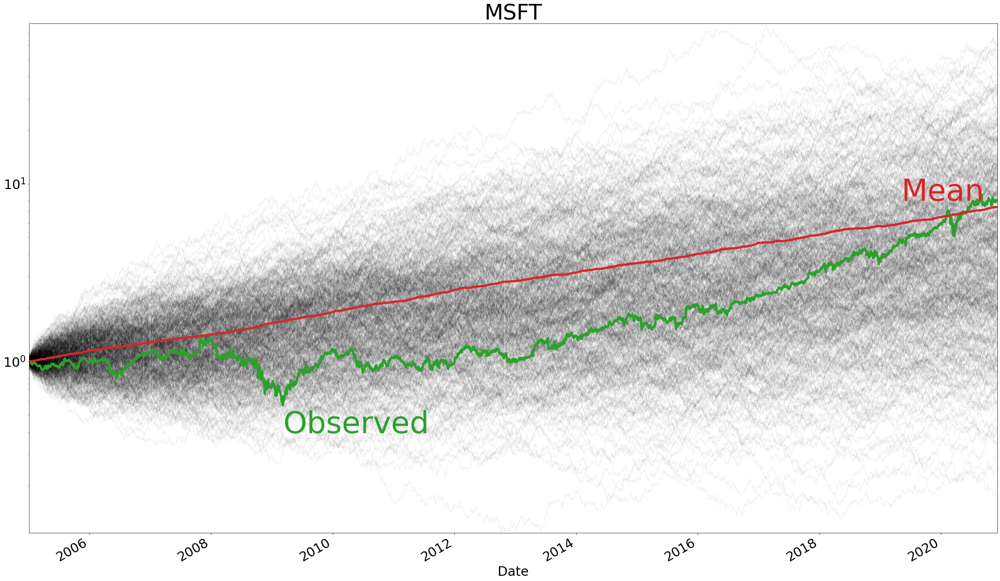

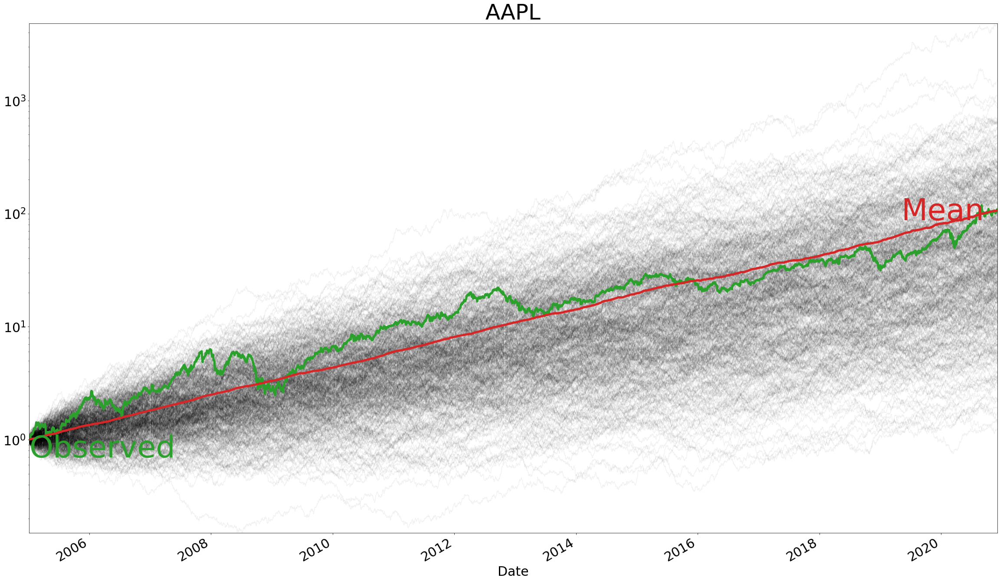

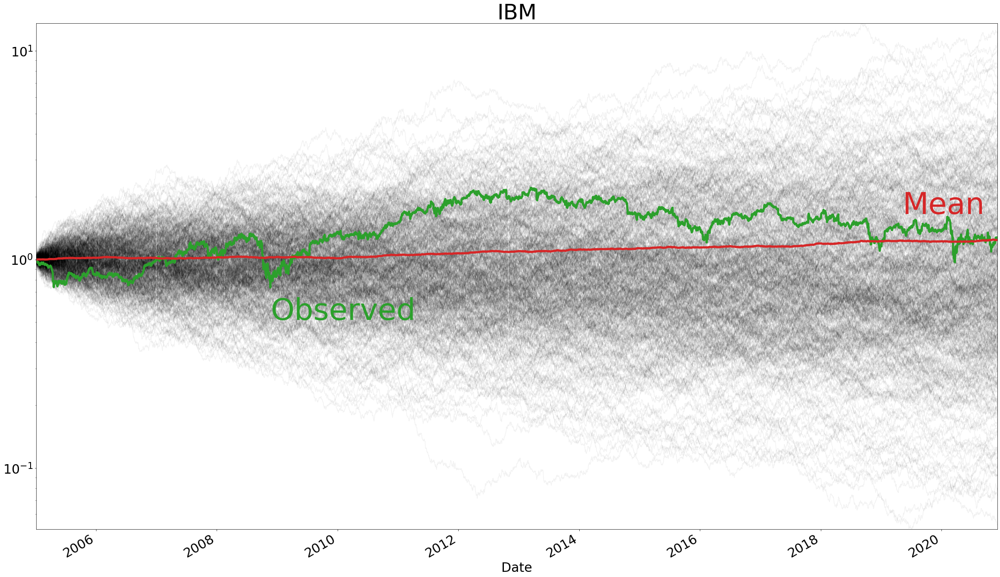

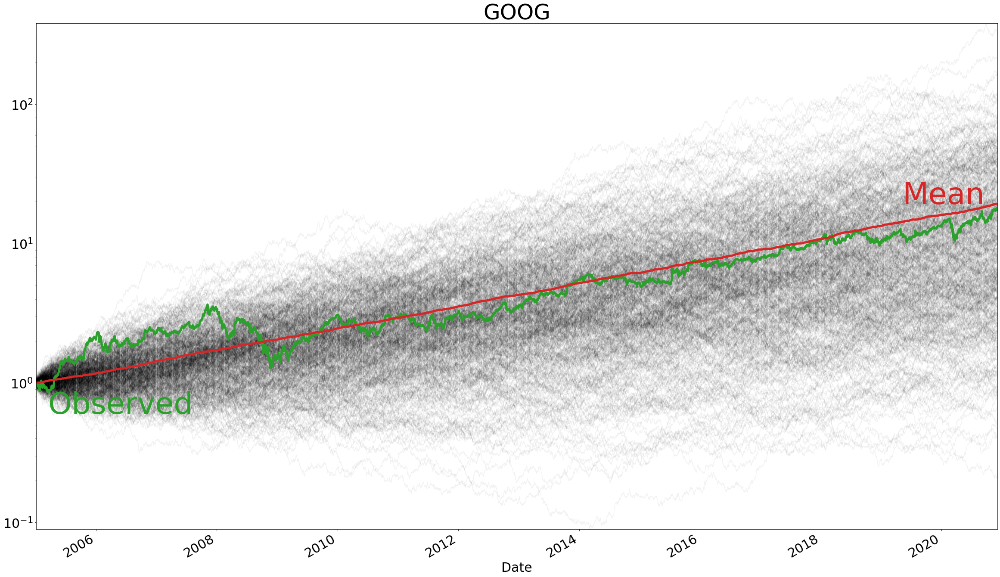

In [18]:
for stock in stocks:
    monte_carlo_sim_dict[stock]["mean"] = monte_carlo_sim_dict[stock].mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    monte_carlo_sim_dict[stock].drop("mean", inplace = False, axis = 1).plot.line(legend = False, marker=".", markersize = .1, 
                                color ="k", alpha = .05, logy = True, ax = ax)
    close_data_normalized[stock].plot.line(legend = False, color ="C2", linewidth = 5, logy = True, ax = ax, label = "Observed")
    monte_carlo_sim_dict[stock]["mean"].plot.line(legend = False, color ="C3", linewidth = 5, logy = True, ax = ax)
    
    # find lowest
    obs_text_x = close_data_normalized[close_data_normalized[stock] == close_data_normalized[stock].min()].index
    plt.text(obs_text_x, close_data_normalized[stock].loc[obs_text_x] * .7 , 
         "Observed", fontsize = 70, color = "C2")
    plt.text(dates[-400], monte_carlo_sim_dict[stock]["mean"].iloc[-400] * 1.35 , 
         "Mean", fontsize = 70, color = "C3")
    
    plt.title(stock, fontsize = 50)
    plt.show()
    plt.close()

## Calculate Portfolio Return

In [19]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [20]:
ex_return  = pd.DataFrame(close_data_normalized.apply(lambda x: x.mul(portfolio_weights[x.name]), axis = 0).sum(axis = 1), 
                         columns = ["Portfolio Return"])
ex_return

,Portfolio Return
Date,
2005-01-03,1.000000
2005-01-04,0.990692
2005-01-05,0.990610
2005-01-06,0.983643
2005-01-07,1.006923
2005-01-10,1.008229
2005-01-11,0.986581
2005-01-12,0.993409
2005-01-13,1.003779


In [21]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001297
2005-01-11,-0.021472
2005-01-12,0.006922
2005-01-13,0.010439
2005-01-14,0.004986


In [22]:
mean_var_df = pd.DataFrame({"mean": (ex_return.iloc[-1] / ex_return.iloc[0]) ** (1 / ex_return["Portfolio Return"].count()) - 1,
                           "sigma":ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000879,0.016605


In [23]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]


for i in range(num_sims):
    monte_carlo_sim_dict[i] = {}
    curr_sim = monte_carlo_sim_dict[i]
    for date in dates:
        # create variable that references simulation i 
        # in the dictionary
        curr_sim[date] = random.normalvariate(mean, sigma)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,1.028251,1.007784,0.984882,0.995714,0.989796,1.017192,0.997377,0.992334,0.975715,1.011665,...,0.987331,1.013245,1.006503,0.990889,1.026475,1.021888,0.999878,0.970293,1.007415,0.971924
2005-01-04,1.035298,0.993112,0.993459,0.976534,0.973738,1.025791,0.986050,0.991693,0.974487,1.011066,...,0.991917,1.020688,0.986032,0.983081,1.033752,0.996635,1.008097,0.956550,0.997033,0.981668
2005-01-05,1.044496,0.975698,0.994681,0.958090,0.991058,1.036672,0.990788,0.974755,1.012036,0.998758,...,0.996484,1.012812,0.987105,0.940771,1.004276,0.948409,1.001748,0.945829,1.014459,0.956407
2005-01-06,1.053090,1.000047,1.004179,0.928347,0.985055,1.040228,1.004671,0.993808,0.980968,0.973510,...,0.983167,1.004523,0.975649,0.936459,0.982704,0.941147,1.016960,0.944666,1.042685,0.962718
2005-01-07,1.053756,0.984331,0.988536,0.926728,1.018676,1.023529,1.059282,0.977601,0.964524,0.978255,...,0.975408,1.030202,0.977761,0.931124,0.973034,0.947028,1.012077,0.960238,1.048768,0.971168
2005-01-10,1.057084,0.994176,0.987517,0.944757,1.020845,1.015816,1.029169,1.025138,0.942204,0.989043,...,0.985724,1.049400,0.997734,0.922910,1.001243,0.942047,1.025904,0.973235,1.030293,0.956215
2005-01-11,1.031956,0.999462,0.967849,0.950372,1.010505,1.033645,1.034529,1.000207,0.944562,0.988418,...,0.995146,1.055568,0.979850,0.929318,0.999409,0.928219,1.042904,0.981423,1.036745,0.935332
2005-01-12,1.016259,0.974401,1.009001,0.974517,1.032127,1.032673,1.024508,0.993860,0.939286,0.975455,...,0.979180,1.028774,0.976675,0.943730,1.020933,0.929214,1.059372,0.950765,1.025093,0.928070
2005-01-13,1.005894,0.968374,0.996137,0.984379,1.032580,1.048723,1.017925,0.984905,0.941670,0.968194,...,0.999768,1.041188,0.939414,0.953269,1.019264,0.946236,1.058689,0.930219,1.017832,0.923389
2005-01-14,1.032739,0.967089,0.996668,0.986806,1.034480,1.028272,1.009081,0.992377,0.947601,0.974094,...,1.027923,1.035923,0.940403,0.968759,1.020035,0.957965,1.058144,0.908115,1.009144,0.906412


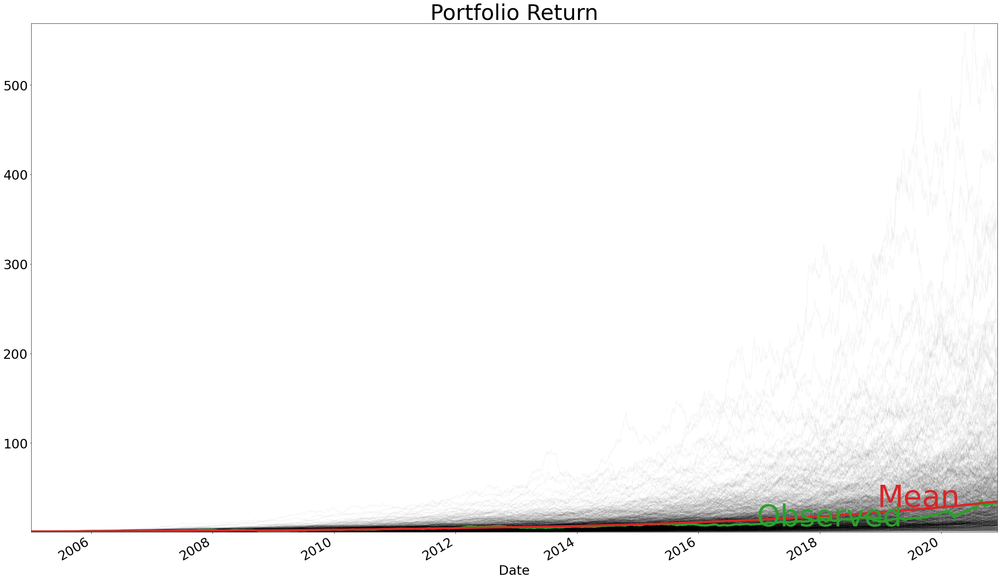

In [24]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis=1)
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(
                            legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, ax = ax)
ex_return.plot.line(legend = False, color ="C2", linewidth = 5, 
                    ax = ax)
plt.text(dates[-1000], ex_return["Portfolio Return"].iloc[-1000] * .75 , 
         "Observed", fontsize = 70, color = "C2")
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", 
                                     linewidth = 5, 
                                     ax = ax)
plt.text(dates[-500], monte_carlo_sim_df["mean"].iloc[-500] * 1.3, "Mean", 
          fontsize = 70, color = "C3")

plt.title("Portfolio Return", fontsize = 70)
plt.show()
plt.close()

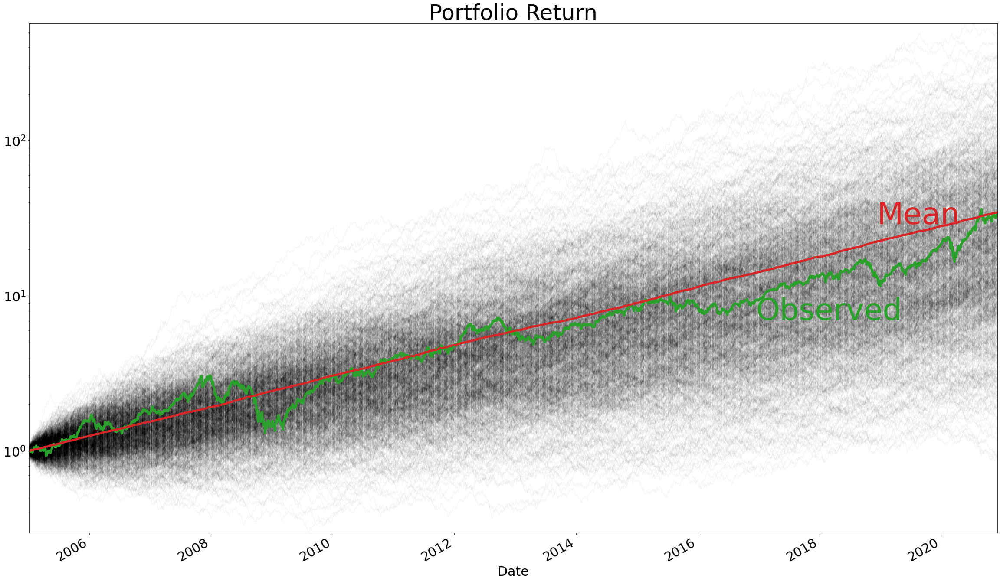

In [25]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis=1)
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.drop("mean", inplace = False, axis = 1).plot.line(
                            legend = False, marker=".", markersize = .1, 
                            color ="k", alpha = .035, logy = True, ax = ax)
ex_return.plot.line(legend = False, color ="C2", linewidth = 5, logy = True, 
                    ax = ax)
plt.text(dates[-1000], ex_return["Portfolio Return"].iloc[-1000] * .75 , 
         "Observed", fontsize = 70, color = "C2")
monte_carlo_sim_df["mean"].plot.line(legend = False, color ="C3", 
                                     linewidth = 5, 
                                     logy = True, ax = ax)
plt.text(dates[-500], monte_carlo_sim_df["mean"].iloc[-500] * 1.3, "Mean", 
          fontsize = 70, color = "C3")

plt.title("Portfolio Return", fontsize = 70)
plt.show()
plt.close()